# start

## import

In [1]:
import geopandas as gpd
from typing import Union
from shapely.geometry import (
    Point, LineString, MultiLineString,
    Polygon, MultiPolygon, GeometryCollection,
    MultiPoint
)

import os
import numpy as np
from sklearn.cluster import MeanShift, estimate_bandwidth
from sklearn.cluster import KMeans
from typing import List
from shapely.validation import make_valid
from IPython.display import display
import folium
import hdbscan
from pyproj import Transformer
from shapely import convex_hull
from shapely.ops import unary_union
from shapely import union_all
from sklearn.cluster import DBSCAN
from shapely.ops import split
from shapely import ops
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
from blocksnet.blocks.cutting import preprocess_urban_objects
from blocksnet.blocks.cutting import cut_urban_blocks
from blocksnet.machine_learning.classification import BlocksClassifier

## load_data

In [3]:
import os
data_path = "/root/blocksnet/tests/cutter_data"

blocks_gdf = gpd.read_parquet(os.path.join(data_path, "blocks.parquet"))

boundaries_gdf = gpd.read_parquet(os.path.join(data_path, "boundaries.parquet"))

roads_gdf = gpd.read_parquet(os.path.join(data_path, "roads.parquet"))
water_gdf = gpd.read_parquet(os.path.join(data_path, "water.parquet"))
buildings_gdf = gpd.read_parquet(os.path.join(data_path, "buildings.parquet"))

In [4]:
crs = boundaries_gdf.estimate_utm_crs()
boundaries_gdf = boundaries_gdf.to_crs(crs)

blocks_gdf = blocks_gdf.to_crs(crs)

roads_gdf = roads_gdf.to_crs(crs)
water_gdf = water_gdf.to_crs(crs)
buildings_gdf = buildings_gdf.to_crs(crs)

In [5]:
bounds_gdf = boundaries_gdf.explode(index_parts=True).reset_index(drop=True)

# filt_data

## filt

In [6]:
def find_objects_within_boundary(boundary, 
                                 objects_gdf : gpd.GeoDataFrame):
    within_objects = gpd.sjoin(objects_gdf, 
                              gpd.GeoDataFrame(geometry=[boundary], crs="EPSG:32636"),
                              predicate='within')
    return within_objects

In [7]:
def get_result_blocks(buildings_gdf : gpd.GeoDataFrame,
                       blocks_gdf : gpd.GeoDataFrame, 
                       water_gdf : gpd.GeoDataFrame, 
                       roads_gdf : gpd.GeoDataFrame):
    blocks_sorted = blocks_gdf.copy()
    blocks_sorted['area'] = blocks_sorted.geometry.area
    blocks_sorted = blocks_sorted.sort_values('area', ascending=False)

    results_blocks = []
    for idx, block in blocks_sorted.iterrows():
        boundary_geom = block.geometry
        
        buildings_in_boundary = find_objects_within_boundary(boundary_geom, buildings_gdf)
        water_in_boundary = find_objects_within_boundary(boundary_geom, water_gdf)
        roads_in_boundary = find_objects_within_boundary(boundary_geom, roads_gdf)
        # blocks_in_boundary = find_objects_within_boundary(boundary_geom, blocks_gdf)
        
        result = {
            'block_id': idx,
            'block_geometry': boundary_geom,
            'buildings': buildings_in_boundary,
            'water_objects': water_in_boundary,
            'roads': roads_in_boundary,
            # 'blocks': blocks_in_boundary
        }
        
        results_blocks.append(result)

    return results_blocks

## show

In [8]:
def show_filt_block(block : dict, crs):
    bound_gdf = gpd.GeoDataFrame(geometry=[block['block_geometry']], crs=crs)

    
    m = bound_gdf.explore(
        name="Boundary", 
        color="lightyellow", 
        style_kwds={'fillOpacity': 0.1, 'weight': 3}
    )
    if not block['buildings'].empty:
        buildings_layer = block['buildings'].explore(
            m=m,
            name="Buildings",
            color="darkblue",
            style_kwds={'fillOpacity': 0.5},
            marker_kwds={'radius': 2} if block['buildings'].geometry.type.iloc[0] == 'Point' else None
        )

        
    if not block['water_objects'].empty:
        water_layer = block['water_objects'].explore(
            m=m,
            name="Water",
            color="cyan",
            style_kwds={'fillOpacity': 0.7}
        )

    if not block['roads'].empty:
        roads_layer = block['roads'].explore(
            m=m,
            name="Roads",
            color="grey",
            style_kwds={'weight': 1.5}
        )

    folium.LayerControl().add_to(m)
    display(m)

# clusters

## clust

In [9]:
def clusters(buildings_gdf : gpd.GeoDataFrame):
    builds_gdf = buildings_gdf.copy()
    builds_gdf['center'] = builds_gdf.geometry.centroid
    coords = np.array([[point.x, point.y] for point in builds_gdf.center])

    clusterer = hdbscan.HDBSCAN(min_cluster_size=10, gen_min_span_tree=True)
    labels = clusterer.fit_predict(coords)
    builds_gdf["cluster"] = labels

    return builds_gdf

## show

In [10]:
def show_clusters(gdf_clustered):

    explored = gdf_clustered.explore(
        column='cluster',
        cmap='Dark2',
        tiles='OpenStreetMap',
        tooltip=True,
        popup=False,
        legend=True,
        name="Buildings by cluster"
    )

    import folium
    folium.LayerControl().add_to(explored)
    display(explored)

# convex_hull

## make_convex_hulls

In [11]:
def make_convex_hulls(clustered_gdf : gpd.GeoDataFrame):
    clusters = clustered_gdf['cluster'].unique()
    convex_hulls = []

    for cluster_id in clusters:
        if cluster_id == -1:
            continue

        cluster_points = clustered_gdf[clustered_gdf["cluster"] == cluster_id]

        if len(cluster_points) < 2:
            continue 
        
        combined = cluster_points.union_all()
        hull = convex_hull(combined)

        convex_hulls.append({
            "cluster": cluster_id,
            "geometry": hull
        })
    
    hull_gdf = gpd.GeoDataFrame(convex_hulls, crs=clustered_gdf.crs)

    return hull_gdf


## show

In [12]:
def show_convex_hulls(hull_gdf : gpd.GeoDataFrame, 
                      clustered_gdf : gpd.GeoDataFrame):
    explored = hull_gdf.explore(
        color="gray",
        tooltip=True,
        popup=False,
        name="Convex Hulls"
    )

    clustered_gdf.explore(
        m=explored,
        column="cluster",
        cmap="Dark2",
        tooltip=True,
        popup=False,
        name="Buildings by cluster"
    )

    folium.LayerControl().add_to(explored)
    display(explored)

# extend_lines

In [13]:
def extend_line(start_point : Point, direct_point : Point, extend_len : float):
    dx =  - direct_point.x + start_point.x
    dy =  - direct_point.y + start_point.y

    extended_point = Point(start_point.x + dx*extend_len, 
                              start_point.y + dy*extend_len)
    
    extension_line = LineString([start_point, extended_point])

    return extension_line

In [14]:
def get_first_intersection(geom, reference_line):
    if geom.is_empty:
        # print('none')
        return None
        
    if geom.geom_type == "Point":
        return geom
    elif geom.geom_type == "MultiPoint":
        start_point = Point(reference_line.coords[0])
        return min(geom.geoms, key=lambda p: p.distance(start_point))
    elif geom.geom_type == "GeometryCollection":
        for item in geom.geoms:
            if item.geom_type == "Point":
                return item
            elif item.geom_type == "MultiPoint":
                start_point = Point(reference_line.coords[0])
                return min(item.geoms, key=lambda p: p.distance(start_point))
    return None

In [15]:
from shapely.geometry import Point, LineString, MultiLineString, Polygon, MultiPolygon
from shapely.ops import unary_union
from shapely.strtree import STRtree
import geopandas as gpd
from tqdm import tqdm


def extend_line(p1: Point, p2: Point, length: float) -> LineString:
    dx, dy = p2.x - p1.x, p2.y - p1.y
    mag = (dx**2 + dy**2)**0.5
    if mag == 0:
        return LineString([p1, p1])
    factor = length / mag
    new_point = Point(p1.x - dx * factor, p1.y - dy * factor)
    return LineString([p1, new_point])


def get_first_intersection(geometry, ref_line):
    if geometry.is_empty:
        return None
    if geometry.geom_type in ["Point", "LineString"]:
        # Проверяем, что пересечение лежит на линии расширения
        if ref_line.distance(geometry) < 1e-8:
            return geometry
        return None
    if geometry.geom_type == "MultiPoint":
        return min(geometry.geoms, key=lambda g: ref_line.project(g))
    if geometry.geom_type == "GeometryCollection":
        points = [g for g in geometry.geoms if g.geom_type == "Point"]
        if points:
            return min(points, key=lambda g: ref_line.project(g))
    return None


def nearest_point(*points, ref_point: Point):
    points = [p for p in points if p]
    return min(points, key=lambda p: ref_point.distance(p)) if points else None


def extend_roads_to_boundary(
    roads: gpd.GeoDataFrame,
    boundary_geom: Polygon | MultiPolygon | LineString | MultiLineString,
    cluster_boundaries: gpd.GeoDataFrame
) -> gpd.GeoDataFrame:

    # Определение глобальной границы
    if isinstance(boundary_geom, (Polygon, MultiPolygon)):
        global_boundary = boundary_geom.boundary
    elif isinstance(boundary_geom, (LineString, MultiLineString)):
        global_boundary = boundary_geom
    else:
        raise TypeError("boundary_geom должен быть Polygon/MultiPolygon или LineString/MultiLineString")

    # Объединяем кластеры
    combined_cluster_poly = unary_union(cluster_boundaries.geometry)
    combined_boundary = unary_union(cluster_boundaries.boundary)

    # Обрезаем дороги по границам кластера
    roads_clipped = gpd.clip(roads, combined_cluster_poly)

    # Пространственный индекс для ускорения поиска пересечений
    road_geoms = list(roads_clipped.geometry)
    str_tree = STRtree(road_geoms)

    extend_len = 1000
    extended_lines = []

    for road in tqdm(road_geoms):
        if isinstance(road, MultiLineString):
            clipped_roads = list(road.geoms)
        elif isinstance(road, LineString):
            clipped_roads = [road]
        else:
            continue

        for clipped_road in clipped_roads:
            coords = list(clipped_road.coords)
            if len(coords) < 2:
                continue

            start, next_start = Point(coords[0]), Point(coords[1])
            end, prev_end = Point(coords[-1]), Point(coords[-2])

            start_line = extend_line(start, next_start, extend_len)
            end_line = extend_line(end, prev_end, extend_len)

            start_b_inter = get_first_intersection(start_line.intersection(combined_boundary), start_line)
            end_b_inter = get_first_intersection(end_line.intersection(combined_boundary), end_line)

            # Получаем индексы ближайших дорог из индекса
            nearby_start_indices = str_tree.query(start_line)
            nearby_start_roads = [road_geoms[i] for i in nearby_start_indices if not road_geoms[i].equals(clipped_road)]

            nearby_end_indices = str_tree.query(end_line)
            nearby_end_roads = [road_geoms[i] for i in nearby_end_indices if not road_geoms[i].equals(clipped_road)]

            start_r_inter = get_first_intersection(
                unary_union([start_line.intersection(g) for g in nearby_start_roads]), start_line
            )
            end_r_inter = get_first_intersection(
                unary_union([end_line.intersection(g) for g in nearby_end_roads]), end_line
            )

            final_start = nearest_point(start_b_inter, start_r_inter, ref_point=start)
            final_end = nearest_point(end_b_inter, end_r_inter, ref_point=end)

            if final_start:
                extended_lines.append(LineString([start, final_start]))
            if final_end:
                extended_lines.append(LineString([end, final_end]))

    return gpd.GeoDataFrame(geometry=extended_lines, crs=roads.crs)


# inters_builds

In [16]:
def get_inters_buildings(line : LineString, 
                         build_gdf : gpd.GeoDataFrame):

    build_gdf_exploded = build_gdf.explode(index_parts=False)
    build_gdf_exploded['intersects'] = build_gdf_exploded.geometry.intersects(line)
    intersected = build_gdf_exploded[build_gdf_exploded['intersects']].drop(columns=['intersects'])
    non_intersected = build_gdf_exploded[~build_gdf_exploded['intersects']].drop(columns=['intersects'])

    return intersected, non_intersected


In [17]:
def line_around_polygon(line : LineString, 
                         polygon : Polygon):
    
    inner_part = line.intersection(polygon)
    outer_parts = line.difference(polygon)

    if outer_parts.is_empty:
        return LineString()
    
    coords = []
    if isinstance(inner_part, LineString):
        coords = list(inner_part.coords)
    elif isinstance(inner_part, MultiLineString):
        if inner_part.geoms:
            coords = list(inner_part.geoms[0].coords) + list(inner_part.geoms[-1].coords)

    if len(coords) < 2:
        return line
    
    start_point = Point(coords[0])
    end_point = Point(coords[-1])

    boundary = polygon.exterior

    start_on_boundary = boundary.interpolate(boundary.project(start_point))
    end_on_boundary = boundary.interpolate(boundary.project(end_point))

    try:
        subpath = ops.substring(
            boundary,
            boundary.project(start_on_boundary),
            boundary.project(end_on_boundary),
            normalized=False
        )
    except ValueError:
        return line
    
    new_line_parts = []

    if outer_parts.geom_type == 'MultiLineString':
        for part in outer_parts.geoms:
            new_line_parts.append(part)
    else:
        new_line_parts.append(outer_parts)

    new_line_parts.append(subpath)

    result_line = ops.linemerge(new_line_parts)

    return result_line if not result_line.is_empty else line

In [18]:
def min_distance_to_buildings(inters_gdf : gpd.GeoDataFrame, 
                              non_inters_gdf : gpd.GeoDataFrame, 
                              buffer_dist : float = 20):
    results = []
    non_inters_gdf = non_inters_gdf.explode(index_parts=False)

    for idx, inters_row in inters_gdf.iterrows():
        inters_geom = inters_row.geometry

        buffer = inters_geom.buffer(buffer_dist)
        
        nearby_buildings = non_inters_gdf[
            (non_inters_gdf.intersects(buffer)) |
            (non_inters_gdf.distance(buffer) < 1e-6)
        ]


        if nearby_buildings.empty:
            continue
        
        distances = nearby_buildings.distance(inters_geom)
        min_dist = distances.min()
        results.append(min_dist)
    
    
    if len(results) == 0:
        return buffer_dist
    
    return min(results)

In [19]:
def new_borderline(line : LineString, 
                   build_gdf : gpd.GeoDataFrame):
    
    inters_build_gdf, non_inters_builds = get_inters_buildings(line, build_gdf[['geometry']])
    buffer_distance = min_distance_to_buildings(inters_build_gdf, non_inters_builds)

    
    inters_build_gdf['buffer_geometry'] = inters_build_gdf.apply(
        lambda row: row.geometry.buffer(
            distance=buffer_distance,
            quad_segs=2
        ),
        axis=1
    )

    multy = unary_union(inters_build_gdf['buffer_geometry'])
    try:
        list_pols = list(multy.geoms)
    except:
        list_pols = [multy]

    modified_border_line = line

    for pol in list_pols:
        modified_border_line = line_around_polygon(modified_border_line, pol)
    
    return modified_border_line

# cut

In [20]:
def cut_to_blocks(roads_with_bounds : gpd.GeoDataFrame,
             water_objects : gpd.GeoDataFrame, 
             big_polygon : Polygon):
    
    lines_gdf, polygons_gdf = preprocess_urban_objects(roads_with_bounds, None, water_objects)

    bound_gdf = gpd.GeoDataFrame(geometry=[big_polygon], crs=roads_with_bounds.crs)
    blocks_res = cut_urban_blocks(boundaries_gdf=bound_gdf, lines_gdf=lines_gdf, polygons_gdf=polygons_gdf, fill_holes=False)

    return blocks_res

# classifier

## classify

In [21]:
def classify(blocks : gpd.GeoDataFrame):
    
    classifier = BlocksClassifier()
    blocks_gdf_classified = classifier.evaluate(blocks)
    blocks_gdf_classified['geometry'] = blocks.geometry
    blocks_gdf_classified = gpd.GeoDataFrame(blocks_gdf_classified, geometry=blocks_gdf_classified.geometry, crs=blocks.crs)

    return blocks_gdf_classified

## show

In [22]:
def show_classified_blocks(blocks_gdf_classified : gpd.GeoDataFrame):
    m = blocks_gdf_classified.explore(
        column="category",
        cmap=["red", "yellow", "green"],
        categories=["BlockCategory.INVALID", "BlockCategory.LARGE", "BlockCategory.NORMAL"],
        legend=True,
        tooltip=["category", "probability"],
        popup=True,
        zoom_start=12
    )
    display(m)

# Combining invalid blocks

In [23]:
import geopandas as gpd
from shapely.geometry import LineString, MultiLineString
from shapely.ops import unary_union
from blocksnet.machine_learning.classification import BlockCategory
import numpy as np

def merge_invalid_blocks(gdf: gpd.GeoDataFrame) -> gpd.GeoDataFrame:
    gdf = gdf.copy()
    
    while True:
        valid_mask = gdf["category"].isin([BlockCategory.NORMAL, BlockCategory.LARGE])
        invalid_mask = gdf["category"] == BlockCategory.INVALID
        merge_candidates = gdf[invalid_mask]
        valid_blocks = gdf[valid_mask]

        if merge_candidates.empty:
            break

        # Создаем пространственный индекс для валидных блоков
        valid_sindex = valid_blocks.sindex
        
        merged_any = False
        drop_indices = []
        
        for idx, row in merge_candidates.iterrows():
            if idx not in gdf.index:
                continue
                
            target_geom = row.geometry
            # Находим потенциальных соседей через пространственный индекс
            possible_matches_idx = list(valid_sindex.query(target_geom, predicate="intersects"))
            possible_matches = valid_blocks.iloc[possible_matches_idx]
            
            if possible_matches.empty:
                continue
                
            # Векторизованный расчет длины пересечений
            def get_shared_length(intersection):
                if isinstance(intersection, LineString):
                    return intersection.length
                elif isinstance(intersection, MultiLineString):
                    return sum(line.length for line in intersection.geoms)
                return 0
                
            intersections = possible_matches.geometry.intersection(target_geom)
            shared_lengths = intersections.apply(get_shared_length)
            
            if shared_lengths.empty or shared_lengths.max() == 0:
                continue
                
            # Находим индекс блока с максимальной длиной пересечения
            matched_idx = possible_matches.index[shared_lengths.argmax()]
            
            # Объединяем геометрии
            new_geom = unary_union([target_geom, gdf.at[matched_idx, 'geometry']])
            gdf.at[matched_idx, 'geometry'] = new_geom
            drop_indices.append(idx)
            merged_any = True
            
            # Прерываем цикл после первого успешного слияния
            if merged_any:
                break
                
        if drop_indices:
            gdf = gdf.drop(index=drop_indices)
            
        if not merged_any:
            break

    return gdf.reset_index(drop=True)


def merge_empty_blocks(gdf: gpd.GeoDataFrame, buildings: gpd.GeoDataFrame) -> gpd.GeoDataFrame:
    gdf = gdf.copy()
    
    # Векторизованная проверка наличия зданий
    buildings_sindex = buildings.sindex
    gdf["has_buildings"] = gpd.GeoSeries(gdf.geometry).apply(
        lambda geom: len(buildings_sindex.query(geom, predicate="intersects")) > 0
    )

    while True:
        empty_mask = ~gdf["has_buildings"] & (gdf["category"] != BlockCategory.INVALID)
        empty_blocks = gdf[empty_mask]
        
        if empty_blocks.empty:
            break
            
        # Создаем пространственный индекс для пустых блоков
        empty_sindex = empty_blocks.sindex
        merged_any = False
        drop_indices = []
        
        for idx, row in empty_blocks.iterrows():
            if idx not in gdf.index:
                continue
                
            target_geom = row.geometry
            # Находим потенциальных соседей через пространственный индекс
            possible_matches_idx = list(empty_sindex.query(target_geom, predicate="intersects"))
            possible_matches = empty_blocks.iloc[possible_matches_idx]
            possible_matches = possible_matches[possible_matches.index != idx]
            
            if possible_matches.empty:
                continue
                
            # Векторизованный расчет длины пересечений
            def get_shared_length(intersection):
                if isinstance(intersection, LineString):
                    return intersection.length
                elif isinstance(intersection, MultiLineString):
                    return sum(line.length for line in intersection.geoms)
                return 0
                
            intersections = possible_matches.geometry.intersection(target_geom)
            shared_lengths = intersections.apply(get_shared_length)
            
            if shared_lengths.empty or shared_lengths.max() == 0:
                continue
                
            # Находим индекс блока с максимальной длиной пересечения
            matched_idx = possible_matches.index[shared_lengths.argmax()]
            
            # Объединяем геометрии
            new_geom = unary_union([target_geom, gdf.at[matched_idx, 'geometry']])
            gdf.at[matched_idx, 'geometry'] = new_geom
            drop_indices.append(idx)
            merged_any = True
            
            # Прерываем цикл после первого успешного слияния
            if merged_any:
                break
                
        if drop_indices:
            gdf = gdf.drop(index=drop_indices)
            
        if not merged_any:
            break

    return gdf.drop(columns="has_buildings").reset_index(drop=True)

In [24]:
import geopandas as gpd
from shapely.geometry import box
from shapely.ops import unary_union
import pandas as pd

def replace_large_with_grid(gdf, category_column, large_value, step):
    """
    Заменяет полигоны с категорией `large_value` на сетку с заданным шагом.
    
    :param gdf: исходный GeoDataFrame
    :param category_column: имя колонки с категорией (str)
    :param large_value: значение, обозначающее "LARGE" (например, BlockCategory.LARGE)
    :param step: размер ячейки сетки в единицах CRS
    :return: GeoDataFrame с заменёнными LARGE-полигонами на сетку
    """
    
    # 1. Фильтруем large
    large_gdf = gdf[gdf[category_column] == large_value]
    if large_gdf.empty:
        return gdf.copy()
    
    # 2. Объединяем геометрию
    merged_geom = unary_union(large_gdf.geometry)
    
    # 3. Генерируем сетку и пересекаем с объединённым large-полигоном
    minx, miny, maxx, maxy = merged_geom.bounds
    grid_cells = []
    x = minx
    while x < maxx:
        y = miny
        while y < maxy:
            cell = box(x, y, x + step, y + step)
            if cell.intersects(merged_geom):
                intersection = cell.intersection(merged_geom)
                if not intersection.is_empty:
                    grid_cells.append(intersection)
            y += step
        x += step

    # 4. Создаём новый GeoDataFrame с сеткой
    grid_gdf = gpd.GeoDataFrame({
        category_column: [large_value] * len(grid_cells),
        'geometry': grid_cells
    }, crs=gdf.crs)

    # 5. Удаляем старые large-полигоны и добавляем сетку
    gdf_no_large = gdf[gdf[category_column] != large_value]
    gdf_updated = pd.concat([gdf_no_large, grid_gdf], ignore_index=True)
    
    return gdf_updated


# test

In [25]:
# res = get_result_blocks(buildings_gdf, blocks_gdf, water_gdf, roads_gdf)
# res_0 = res[0]

Получено 14231 линейных объектов


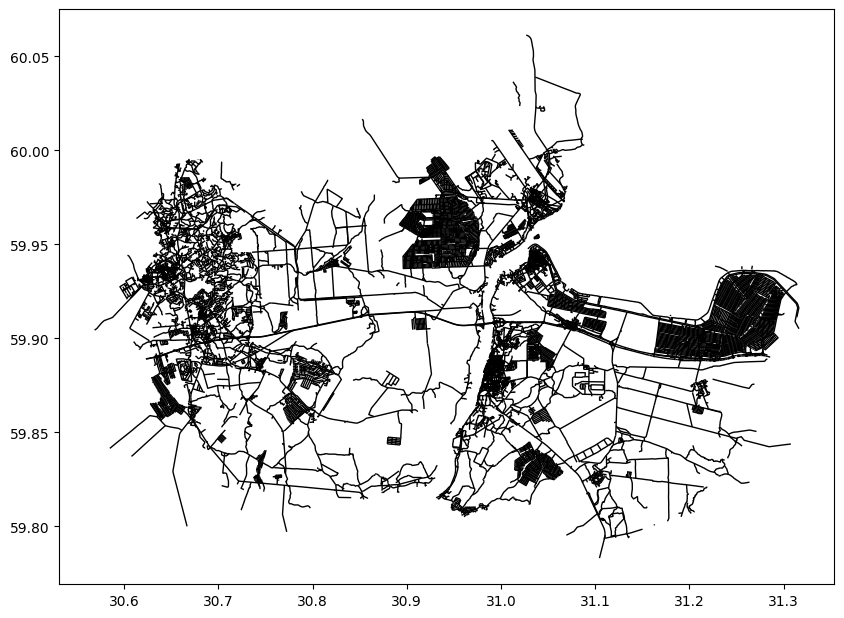

In [26]:
import osmnx as ox
import geopandas as gpd
from shapely.ops import unary_union
import matplotlib.pyplot as plt

# Предполагается, что boundaries_gdf — GeoDataFrame с геометриями
# Проверяем и преобразуем в нужную проекцию (WGS84, EPSG:4326)
boundaries_gdf = boundaries_gdf.to_crs(epsg=4326)

# Проверяем валидность геометрий
if not boundaries_gdf.geometry.is_valid.all():
    boundaries_gdf['geometry'] = boundaries_gdf.geometry.buffer(0)  # Исправляем невалидные геометрии

# Объединяем геометрии в один полигон
polygon = unary_union(boundaries_gdf.geometry)

# Теги для линейных объектов (исключаем точки)
tags = {
    'highway': [
        'motorway', 'trunk', 'primary', 'secondary', 'tertiary', 'unclassified', 'residential',
        'motorway_link', 'trunk_link', 'primary_link', 'secondary_link', 'tertiary_link',
        'living_street', 'service', 'track', 'escape', 'pedestrian', 'path', 'footway',
        'cycleway', 'bridleway', 'steps', 'bus_guideway', 'raceway', 'construction'
    ]
}

# Загружаем геометрии дорог
try:
    roads = ox.features_from_polygon(polygon, tags=tags)
except Exception as e:
    print(f"Ошибка при загрузке данных: {e}")
    roads = gpd.GeoDataFrame()  # Пустой GeoDataFrame на случай ошибки

# Фильтруем только LineString и MultiLineString
roads = roads[roads.geometry.type.isin(['LineString', 'MultiLineString'])]

# Проверяем, что данные получены
if roads.empty:
    print("Линейные объекты не найдены. Проверьте полигон или теги.")
else:
    print(f"Получено {len(roads)} линейных объектов")

# Визуализация
roads.plot(figsize=(10, 10), edgecolor='black', linewidth=1)
plt.show()

In [27]:
roads = roads.to_crs(crs)
boundaries_gdf = boundaries_gdf.to_crs(crs)

In [28]:
res_0 = {
            'block_id': 1,
            'block_geometry': unary_union(boundaries_gdf.geometry),
            'buildings': buildings_gdf,
            'water_objects': water_gdf,
            'roads': roads,
            # 'blocks': blocks_in_boundary
        }

In [29]:
# show_filt_block(res_0, crs)

In [30]:
clust = clusters(res_0['buildings'])

/root/blocksnet/.venv/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/root/blocksnet/.venv/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


In [31]:
# show_clusters(clust)

In [32]:
hull_gdf = make_convex_hulls(clust)

In [33]:
# show_convex_hulls(hull_gdf, clust)

## extend

In [34]:
roads_copy = res_0['roads'].copy()
# new_roads = extend_roads_to_boundary(roads_copy, res_0['block_geometry'], cluster_boundaries=hull_gdf)

In [35]:
# m = hull_gdf.explore(
#     name="Boundary", 
#     color="red", 
#     style_kwds={'fillOpacity': 0.1, 'weight': 3}
# )
# if not new_roads.empty:
#     buildings_layer = new_roads.explore(
#         m=m,
#         name="Buildings",
#         color="darkblue",
#         style_kwds={'fillOpacity': 0.5},
#     )

# if not roads_copy.empty:
#     buildings_layer = roads_copy.explore(
#         m=m,
#         name="roads_copy",
#         color="green",
#         style_kwds={'fillOpacity': 0.5},
#     )


# folium.LayerControl().add_to(m)
# display(m)

In [36]:
# new_roads['new_geometry'] = new_roads['geometry']
# for idx, row in tqdm(new_roads.iterrows(), total=len(new_roads)):
#     geom = row['geometry']
#     if geom is None or geom.is_empty:
#         new_roads.at[idx, 'new_geometry'] = geom 
#     else:
#         new_roads.at[idx, 'new_geometry'] = new_borderline(geom, res_0['buildings'])

# new_roads['geometry'] = new_roads['new_geometry']
# new_roads = new_roads.drop(columns=['new_geometry'])

# # print("Пустые геометрии после обработки:")
# # print(new_roads[new_roads['geometry'].is_empty])

In [37]:
all_roads = gpd.GeoDataFrame(pd.concat([ res_0['roads']], ignore_index=True), crs=res_0['roads'].crs)

In [38]:
# Извлекаем границы полигонов как LineString
polygon_boundaries = hull_gdf.boundary

# Создаем GeoDataFrame с границами полигонов
boundaries_gdf = gpd.GeoDataFrame(geometry=polygon_boundaries)

# Объединяем GeoDataFrame с линиями и границами полигонов
new_roads_with_bounds = gpd.GeoDataFrame(pd.concat([all_roads, boundaries_gdf, res_0['roads']], ignore_index=True))

# Сбрасываем индекс, если нужно
new_roads_with_bounds = new_roads_with_bounds.reset_index(drop=True)

In [39]:
new_roads_with_bounds = new_roads_with_bounds[['geometry']]

In [40]:
new_roads_with_bounds.explore()

## cut

In [41]:
blocks_res = cut_to_blocks(new_roads_with_bounds, res_0['water_objects'], res_0['block_geometry'])

2025-06-06 12:51:06.846 | INFO     | blocksnet.blocks.cutting.preprocessing.core:preprocess_urban_objects:44 - Checking roads schema
2025-06-06 12:51:06.876 | INFO     | blocksnet.blocks.cutting.preprocessing.core:preprocess_urban_objects:51 - Checking railways schema
2025-06-06 12:51:06.877 | WARNING  | blocksnet.blocks.cutting.preprocessing.core:preprocess_urban_objects:53 - Railways GeoDataFrame is None. Creating empty
2025-06-06 12:51:06.880 | INFO     | blocksnet.blocks.cutting.preprocessing.core:preprocess_urban_objects:58 - Checking water schema
2025-06-06 12:51:06.901 | INFO     | blocksnet.blocks.cutting.processing.core:wrapper:21 - Checking boundaries schema
2025-06-06 12:51:06.910 | INFO     | blocksnet.blocks.cutting.processing.core:wrapper:25 - Checking line objects schema
2025-06-06 12:51:06.955 | INFO     | blocksnet.blocks.cutting.processing.core:wrapper:31 - Checking polygon objects schema
2025-06-06 12:51:06.969 | INFO     | blocksnet.blocks.cutting.processing.core:_e

In [43]:
blocks_res.explore()

In [44]:
blocks_gdf_classified = classify(blocks_res)

2025-06-06 12:51:52.792 | INFO     | blocksnet.preprocessing.feature_engineering.core:_calculate_usual_features:35 - Calculating usual features
2025-06-06 12:51:53.061 | INFO     | blocksnet.preprocessing.feature_engineering.core:_calculate_aspect_ratios:58 - Calculating aspect ratios
100%|██████████| 10846/10846 [00:00<00:00, 27852.53it/s]
2025-06-06 12:51:53.455 | INFO     | blocksnet.preprocessing.feature_engineering.core:_calculate_centerlines:21 - Calculating centerlines
100%|██████████| 10846/10846 [00:17<00:00, 612.56it/s] 
2025-06-06 12:52:11.197 | INFO     | blocksnet.preprocessing.feature_engineering.core:_generate_combinations:68 - Generating combinations


In [ ]:
show_classified_blocks(blocks_gdf_classified)

## merge

In [45]:
combined_gdf = merge_invalid_blocks(blocks_gdf_classified)
combined_gdf = merge_empty_blocks(combined_gdf, res_0["buildings"])
combined_gdf.explore(
    column="category",
    cmap=["red", "yellow", "green"],
    categories=["BlockCategory.INVALID", "BlockCategory.LARGE", "BlockCategory.NORMAL"],
    legend=True,
    tooltip=["category", "probability"],
    popup=True,
    zoom_start=12
)